# Q4 XGBoost

In [25]:
from datetime import datetime
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sys
import pickle
import missingno as msno
from scipy.stats import zscore
pd.set_option('display.max_columns', None)
np.set_printoptions(threshold=sys.maxsize)

from xgboost import XGBClassifier, XGBRegressor
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import accuracy_score, roc_curve, auc, confusion_matrix, roc_auc_score
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectFromModel


In [26]:
def compute_performance(yhat, y, classes):
    # First, get tp, tn, fp, fn
    tp = sum(np.logical_and(yhat == classes[1], y == classes[1]))
    tn = sum(np.logical_and(yhat == classes[0], y == classes[0]))
    fp = sum(np.logical_and(yhat == classes[1], y == classes[0]))
    fn = sum(np.logical_and(yhat == classes[0], y == classes[1]))
    print(f"tp: {tp} tn: {tn} fp: {fp} fn: {fn}")
    
    # Accuracy
    acc = (tp + tn) / (tp + tn + fp + fn)
    
    # Precision
    # "Of the ones I labeled +, how many are actually +?"
    precision = tp / (tp + fp)
    
    # Recall
    # "Of all the + in the data, how many do I correctly label?"
    recall = tp / (tp + fn)    
    
    # Sensitivity
    # "Of all the + in the data, how many do I correctly label?"
    sensitivity = recall
    
    # Specificity
    # "Of all the - in the data, how many do I correctly label?"
    specificity = tn / (fp + tn)
    
    # Print results
    
    print("Accuracy:",round(acc,6),"Recall:",round(recall,6),"Precision:",round(precision,6),
          "Sensitivity:",round(sensitivity,6),"Specificity:",round(specificity,6))

In [27]:
def cf_matrix(ypred, ytrue):
    from sklearn.metrics import confusion_matrix
    import pandas as pd
    import numpy as np
    c_matrix = confusion_matrix(ytrue, ypred)
    c_matrix_pct = c_matrix.astype('float') / c_matrix.sum(axis=1)[:, np.newaxis]
    # Turn to dataframe
    df_cm = pd.DataFrame(
            c_matrix_pct, index=['Others', 'Bad'], columns=['Others', 'Bad'], 
    )
    # Parameters of the image
    figsize = (5,4)
    fontsize=10
    # Create image
    fig = plt.figure(figsize=figsize)
    heatmap = sns.heatmap(df_cm, annot=True, fmt='.2f')
    # Make it nicer
    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, 
                                ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45,
                                ha='right', fontsize=fontsize)
    # Add labels
    plt.ylabel('True Loan Status')
    plt.xlabel('Predicted Loan Status')
    # Plot!
    plt.show()

In [28]:
train = pickle.load(open('Q2_train.pkl','rb'))
test = pickle.load(open('Q2_test.pkl','rb'))

In [29]:
X_train = train.drop(columns = "loan_status")
X_test = test.drop(columns = "loan_status")
y_train = train["loan_status"]
y_test = test["loan_status"]

# Q4 Part 1: One Hot Encoder & XGBoost GridSearch

In [30]:
val_train = train.sample(frac = 0.2, random_state = 251316935)
X_val_train = val_train.drop(columns = "loan_status")
y_val_train = val_train["loan_status"]

val_test = test.sample(frac = 0.2, random_state = 251316935)
X_val_test = val_test.drop(columns = "loan_status")
y_val_test = val_test["loan_status"]


### First grid search trial run

In [7]:
scale_pos = (len(y_train) - sum(y_train))/sum(y_train)
cat_columns = X_train.select_dtypes(object).columns
categorical_features = cat_columns
categorical_transformer = OneHotEncoder(handle_unknown="ignore")
preprocessor = ColumnTransformer(
    transformers=[("cat", categorical_transformer, categorical_features)],
    remainder='passthrough'
)

xgbr = XGBClassifier(
    max_depth=2,            
    learning_rate=0.1,            
    n_estimators=50,             
    verbosity=2,                  
    objective='binary:logistic',  
    booster='gbtree', 
    n_jobs=-1,      
    gamma=0.001, 
    subsample=0.632,
    colsample_bytree=1,
    colsample_bylevel=1, 
    colsample_bynode=1,
    reg_alpha=1,
    reg_lambda=0,
    scale_pos_weight=scale_pos, 
    base_score=0.5, 
    random_state=251316935, 
    tree_method='hist',
    eval_metric = 'auc'
)

param_grid = dict({
    'n_estimators': [100, 200, 300, 600],
    'max_depth': [5, 7, 9, 11],
    'learning_rate' : [0.01, 0.05, 0.1, 0.15]
})

grid_xgb = GridSearchCV(
    xgbr,
    param_grid,
    cv = 3,
    scoring = 'roc_auc',
    n_jobs = -1,
    refit = False,
    verbose = 2,
)

clf = Pipeline(
    steps=[("preprocessor", preprocessor), ("grid_search_cv", grid_xgb)]
)

In [26]:
clf.fit(X_val_train, y_val_train)

Fitting 3 folds for each of 64 candidates, totalling 192 fits
[17:08:36] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[17:08:36] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[17:08:36] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[17:08:36] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[17:08:36] INFO: /User

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


[17:09:53] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[17:09:53] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[17:09:53] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[17:09:53] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[17:09:53] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  Index(['term', 'home_ownership', 'purpose', 'application_type'], dtype='object'))])),
                ('grid_search_cv',
                 GridSearchCV(cv=3,
                              estimator=XGBClassifier(base_score=0.5,
                                                      booster='gbtree',
                                                      callbacks=None,
                                                      colsample_bylevel=1,
                                                      colsampl...
                                                      max_delta_step=None,
                                                      max_depth=2,
                                                      max_leaves=None,
                                                      min_child_weight=None,
                                                      missing=nan,
                                                      monotone_constraints=None,
                                                      n_estimators=50,
                                                      n_jobs=-1,
                                                      num_parallel_tree=None,
                                                      predictor=None,
                                                      random_state=251316935, ...),
                              n_jobs=-1,
                              param_grid={'learning_rate': [0.01, 0.05, 0.1,
                                                            0.15],
                                          'max_depth': [5, 7, 9, 11],
                                          'n_estimators': [100, 200, 300, 600]},
                              refit=False, scoring='roc_auc', verbose=2))])

In [29]:
clf["grid_search_cv"].best_params_

{'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 600}

### GridSearch Re-run

In [31]:
val_train = train.sample(frac = 0.2, random_state = 539613152)
X_val_train = val_train.drop(columns = "loan_status")
y_val_train = val_train["loan_status"]

val_test = test.sample(frac = 0.2, random_state = 539613152)
X_val_test = val_test.drop(columns = "loan_status")
y_val_test = val_test["loan_status"]

In [32]:
param_grid = dict({
    'n_estimators': [500, 600, 700],
    'max_depth': [4, 5, 6],
    'learning_rate' : [0.03, 0.04, 0.05, 0.06, 0.07]
})

grid_xgb = GridSearchCV(
    xgbr,
    param_grid,
    cv = 3,
    scoring = 'roc_auc',
    n_jobs = -1,
    refit = False,
    verbose = 2,
)

clf = Pipeline(
    steps=[("preprocessor", preprocessor), ("grid_search_cv", grid_xgb)]
)

In [33]:
clf.fit(X_val_train, y_val_train)

Fitting 3 folds for each of 45 candidates, totalling 135 fits
[11:29:08] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[11:29:08] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[11:29:09] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[11:29:09] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[11:29:09] INFO: /User

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


[11:35:59] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[11:35:59] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[11:35:59] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[11:35:59] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[11:35:59] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  Index(['term', 'home_ownership', 'purpose', 'application_type'], dtype='object'))])),
                ('grid_search_cv',
                 GridSearchCV(cv=3,
                              estimator=XGBClassifier(base_score=0.5,
                                                      booster='gbtree',
                                                      callbacks=None,
                                                      colsample_bylevel=1,
                                                      colsampl...
                                                      max_delta_step=None,
                                                      max_depth=2,
                                                      max_leaves=None,
                                                      min_child_weight=None,
                                                      missing=nan,
                                                      monotone_constraints=None,
                                                      n_estimators=50,
                                                      n_jobs=-1,
                                                      num_parallel_tree=None,
                                                      predictor=None,
                                                      random_state=251316935, ...),
                              n_jobs=-1,
                              param_grid={'learning_rate': [0.03, 0.04, 0.05,
                                                            0.06, 0.07],
                                          'max_depth': [4, 5, 6],
                                          'n_estimators': [500, 600, 700]},
                              refit=False, scoring='roc_auc', verbose=2))])

In [34]:
clf["grid_search_cv"].best_params_

{'learning_rate': 0.06, 'max_depth': 5, 'n_estimators': 700}

# Q4 Part 2: XGBoost Classifier Tree Number Finetune

In [35]:
cat_columns = X_train.select_dtypes(object).columns
categorical_features = cat_columns
categorical_transformer = OneHotEncoder(handle_unknown="ignore")
preprocessor = ColumnTransformer(
    transformers=[("cat", categorical_transformer, categorical_features)],
    remainder='passthrough'
)

In [36]:
scale_pos = (len(y_train) - sum(y_train))/sum(y_train)

best_xgbc = XGBClassifier(
    max_depth=5,            
    learning_rate=0.06,            
    n_estimators=1200,             
    verbosity=2,                  
    objective='binary:logistic',  
    booster='gbtree', 
    n_jobs=-1,      
    gamma=0.001, 
    subsample=0.632,
    colsample_bytree=1,
    colsample_bylevel=1, 
    colsample_bynode=1,
    reg_alpha=1,
    reg_lambda=0,
    scale_pos_weight=scale_pos, 
    base_score=0.5, 
    random_state=251316935, 
    tree_method='hist',
    early_stopping_rounds=10
)

In [37]:
best_xgb_pipeline = Pipeline(
    steps=[("preprocessor", preprocessor), ("best_xgbc", best_xgbc)]
)
best_xgb_pipeline

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  Index(['term', 'home_ownership', 'purpose', 'application_type'], dtype='object'))])),
                ('best_xgbc',
                 XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, ear...
                               feature_types=None, gamma=0.001, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=0.06,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=5, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=1200,
                               n_jobs=-1, num_parallel_tree=None,
                               predictor=None, random_state=251316935, ...))])

In [38]:
X_train_one_hot = preprocessor.fit_transform(X_train)
X_test_one_hot = preprocessor.fit_transform(X_test)
eval_set = [(X_train_one_hot, y_train),(X_test_one_hot, y_test)]
# best_xgbc.fit(X_train_one_hot, y_train, eval_metric = ['auc', 'logloss'], eval_set = eval_set)
best_xgb_pipeline.fit(
    X_train, y_train, 
    best_xgbc__eval_metric = ['auc', 'logloss'],
    best_xgbc__eval_set = eval_set
)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/xgboost/sklearn.py:861: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(


[11:42:49] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[11:42:49] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[0]	validation_0-auc:0.68514	validation_0-logloss:0.68701	validation_1-auc:0.68266	validation_1-logloss:0.68709
[11:42:50] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0-arm64-cpython-38/xgboost/src/gbm/gbtree.cc:178: Tree method is selected to be 'hist', which uses a single updater grow_quantile_histmaker.
[1]	validation_0-auc:0.68995	validation_0-logloss:0.68146	validation_1-auc:0.68721	validation_1-logloss:0.68162
[11:42:51] INFO: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-11.0

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  Index(['term', 'home_ownership', 'purpose', 'application_type'], dtype='object'))])),
                ('best_xgbc',
                 XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, ear...
                               feature_types=None, gamma=0.001, gpu_id=-1,
                               grow_policy='depthwise', importance_type=None,
                               interaction_constraints='', learning_rate=0.06,
                               max_bin=256, max_cat_threshold=64,
                               max_cat_to_onehot=4, max_delta_step=0,
                               max_depth=5, max_leaves=0, min_child_weight=1,
                               missing=nan, monotone_constraints='()',
                               n_estimators=1200, n_jobs=-1,
                               num_parallel_tree=1, predictor='auto',
                               random_state=251316935, ...))])

# Q4 Part3: Analyze XGBoost Performance and Comparisons

tp: 38405 tn: 135504 fp: 66899 fn: 15315
Accuracy: 0.679006 Recall: 0.714911 Precision: 0.364706 Sensitivity: 0.714911 Specificity: 0.669476


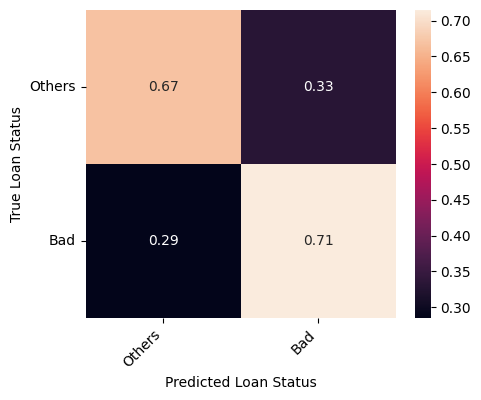

In [46]:
y_pred_proba = best_xgbc.predict_proba(X_test_one_hot)
threshold = 0.5
ypred_new = best_xgbc.classes_[(y_pred_proba[:,1] > threshold).astype(int)]
compute_performance(ypred_new, y_test, best_xgbc.classes_)
cf_matrix(ypred_new, y_test)

Accuracy: 0.679
best ntree: 781


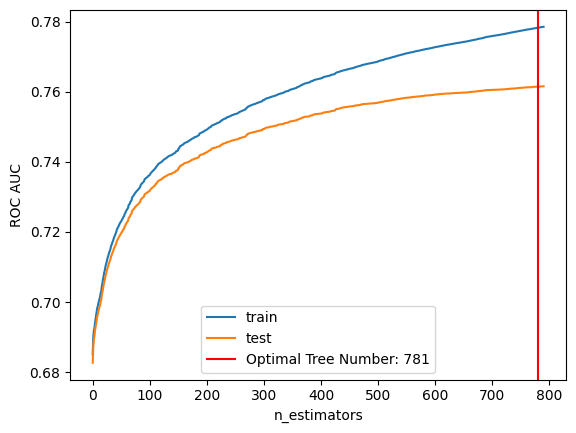

In [47]:
score = accuracy_score(y_test, ypred_new)
print('Accuracy: %.3f' % score)
results = best_xgbc.evals_result()
plt.plot(results['validation_0']['auc'], label='train')
plt.plot(results['validation_1']['auc'], label='test')
plt.axvline(best_xgbc.best_ntree_limit, color="red", label="Optimal Tree Number: 781")
print(f"best ntree: {best_xgbc.best_ntree_limit}")
plt.legend()
plt.xlabel("n_estimators")
plt.ylabel("ROC AUC")
plt.show()

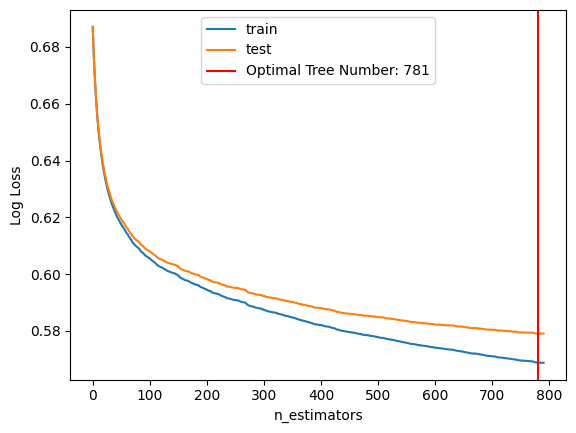

In [41]:
plt.plot(results['validation_0']['logloss'], label='train')
plt.plot(results['validation_1']['logloss'], label='test')
plt.axvline(best_xgbc.best_ntree_limit, color="red", label="Optimal Tree Number: 781")
plt.xlabel("n_estimators")
plt.ylabel("Log Loss")
plt.legend()
plt.show()

### ROC AUC Comparison

In [48]:
pd_model = pickle.load(open('Q3_pd_model.pkl','rb'))
df_woe_iv_cf = pickle.load(open('Q3_X_test_refit.pkl','rb'))
y_logreg_proba =  pd_model.predict_proba(df_woe_iv_cf)

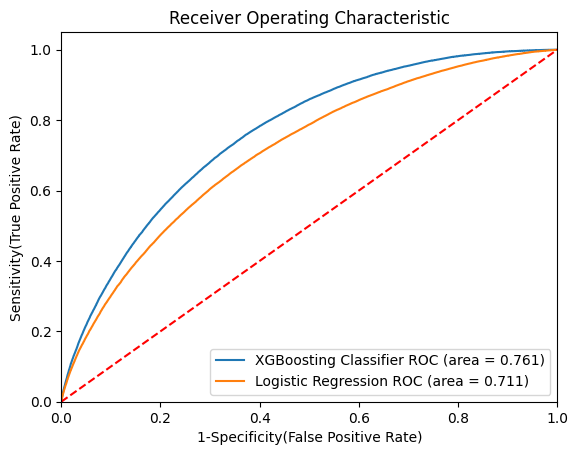

In [49]:
models = [
{
    'label': 'XGBoosting Classifier',
    'probs': y_pred_proba[:,1]
},
{
    'label': 'Logistic Regression',
    'probs': y_logreg_proba[:,1]
}
]

# Loop that creates the plot. I will pass each ROC curve one by one.
for m in models:
    auc = roc_auc_score(
        y_true = y_test, 
        y_score = m['probs']
    )
    fpr, tpr, thresholds = roc_curve(
        y_test, 
        m['probs']
    )
    plt.plot(fpr, tpr, label=f'{m["label"]} ROC (area = {auc:.3f})')
                 

    
# Settings
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('1-Specificity(False Positive Rate)')
plt.ylabel('Sensitivity(True Positive Rate)')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
    
# Plot!    
plt.show()

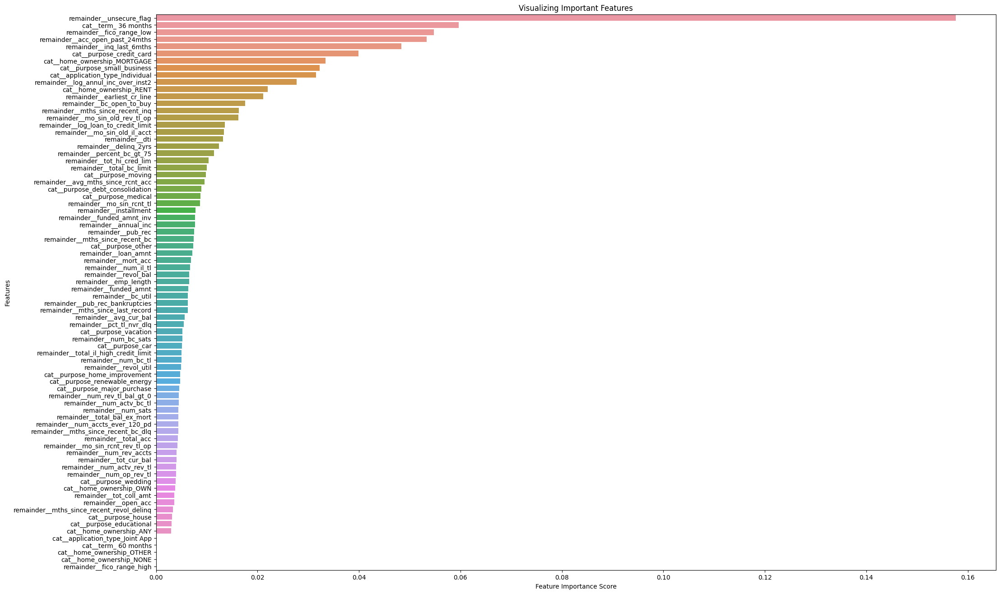

In [50]:
feature_importances = pd.Series(
    best_xgb_pipeline["best_xgbc"].feature_importances_, 
    index=best_xgb_pipeline["preprocessor"].get_feature_names_out()
).sort_values(ascending=False)

plt.figure(figsize=(24, 16))
sns.barplot(x=feature_importances, y=feature_importances.index)
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title('Visualizing Important Features')
plt.show()

# Q4 Complete

In [51]:
pickle.dump(best_xgb_pipeline, open('Q4_best_xgb_pipeline.pkl','wb'))
pickle.dump(best_xgbc, open('Q4_best_xgb.pkl','wb'))
pickle.dump(preprocessor, open('Q4_onehot_encoder.pkl','wb'))
pickle.dump(clf, open('Q4_grid_xgb.pkl','wb'))